# Preprocessing of dataset 3
---

## 0. Enviromental setup

In [1]:
import numpy as np
from skimage.io import imread
from skimage.color import label2rgb
import matplotlib.pyplot as plt
import sys

sys.path.append("../..")
import os
import copy
import tifffile

from src.utils.base import get_file_list
from src.batch.nuclear_segmentation import segment_objects_stardist2d
from src.batch.extract_features import (
    extract_nmco_feats_batch,
    measure_intensity_batch,
    extract_spatial_coordinates_batch,
)
from src.utils.data_viz import visualize_segmentation_results

%load_ext nb_black

<IPython.core.display.Javascript object>

---
## 1. Read in data

In [2]:
img_locs = get_file_list("../../data/dataset3/images/cropped")
file_names = []
dapi_imgs = []
# We read in only the DAPI channel (blue-channel)
for loc in img_locs:
    file_name = os.path.split(loc)[1]
    file_name = file_name[: file_name.index(".")]
    file_names.append(file_name)
    img = imread(loc)
    dapi_img = img[:, :, 2]
    dapi_imgs.append(imread(loc)[:, :, 2])

<IPython.core.display.Javascript object>

## 2. Data normalization

Since we observed strong batch effects in the images with respect to the covered intensity ranges, we quantile-normalize the data using the lower 0.005 and the upper 0.995 quantile.

In [3]:
scaled_dapi_imgs = []
for dapi_img in dapi_imgs:
    # Scale to 8bit each image in cropped region
    masked_dapi_img = np.ma.array(dapi_img, mask=~(dapi_img > 0)).astype(float)
    min_masked_dapi_img = np.quantile(masked_dapi_img, 0.01)
    max_masked_dapi_img = np.quantile(masked_dapi_img, 0.998)
    masked_dapi_img = (masked_dapi_img - min_masked_dapi_img) / (
        max_masked_dapi_img - min_masked_dapi_img
    )
    scaled_dapi_img = masked_dapi_img.filled(fill_value=0)
    scaled_dapi_img = np.clip(scaled_dapi_img * 255, 0, 255).astype(np.uint8)
    scaled_dapi_imgs.append(scaled_dapi_img)

<IPython.core.display.Javascript object>

To show the effect of the normalization we plot the individual ROI images before and after the range normalization alongside their corresponding intensity histograms.

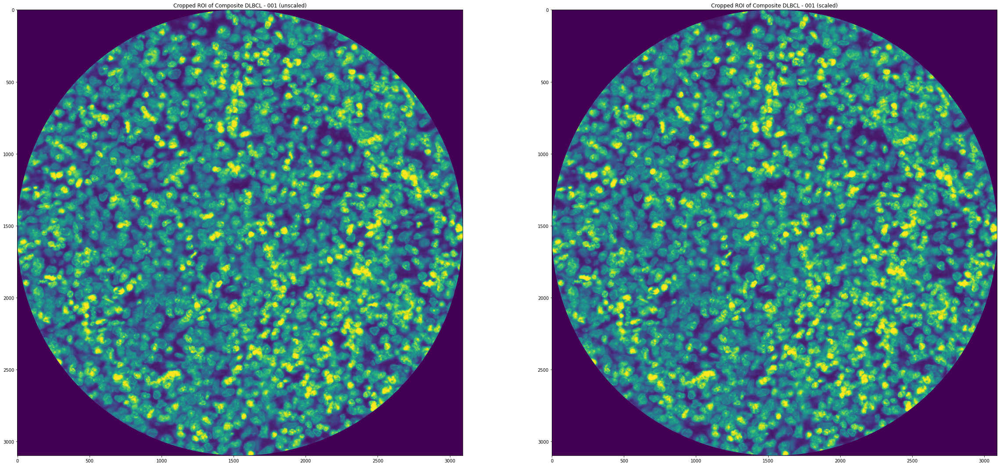

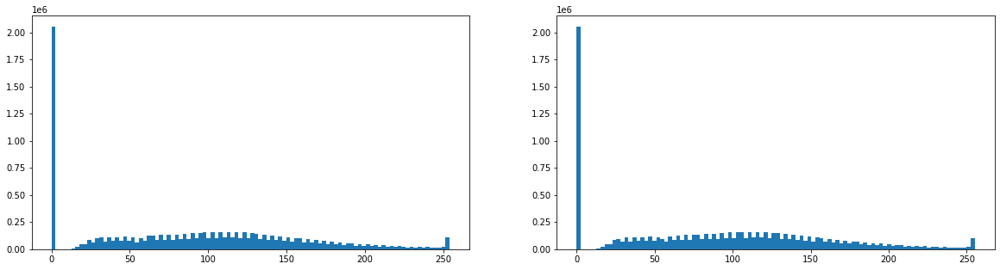

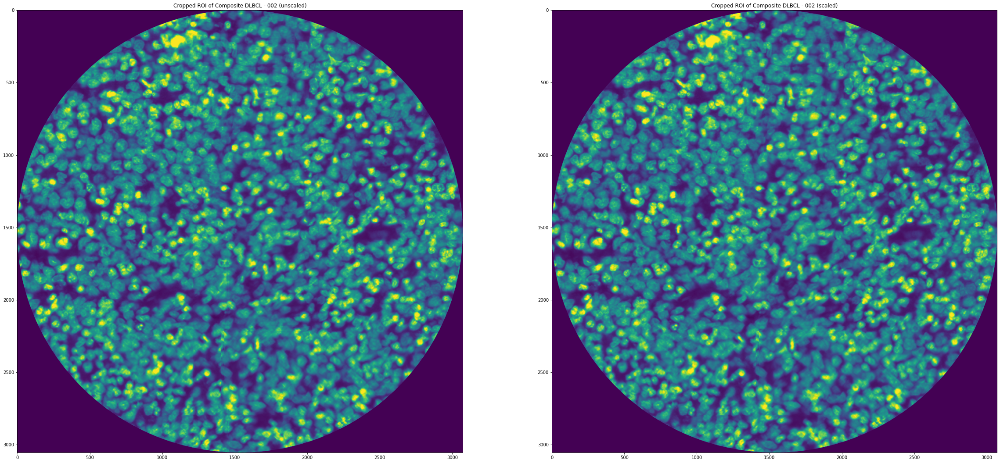

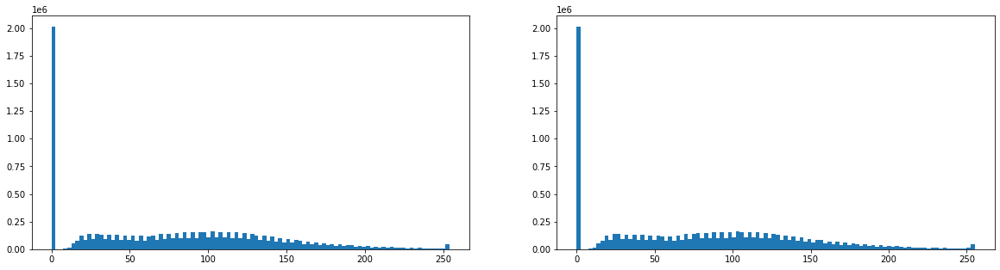

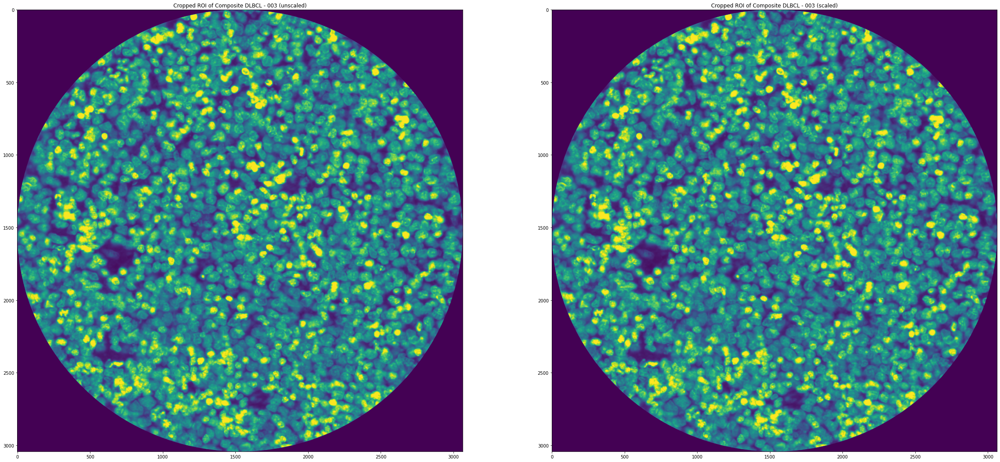

...

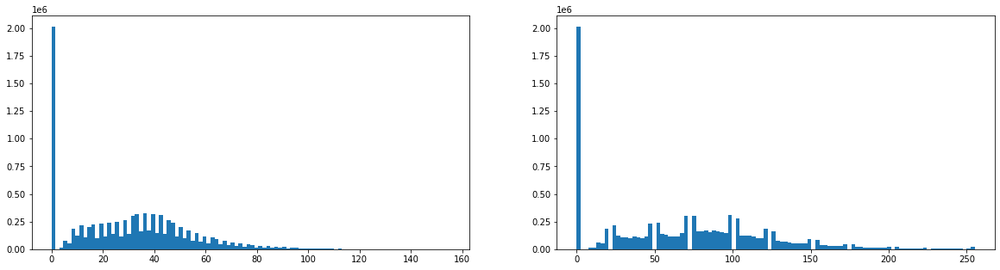

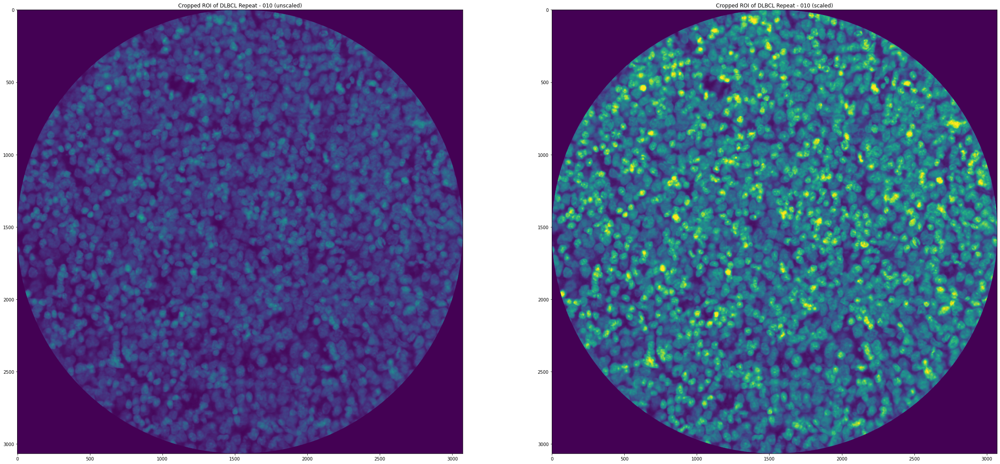

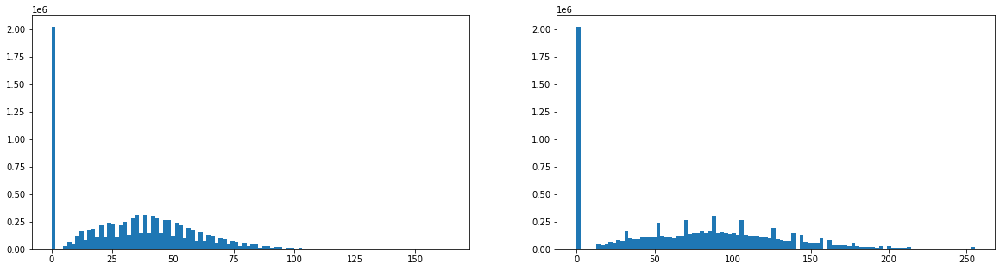

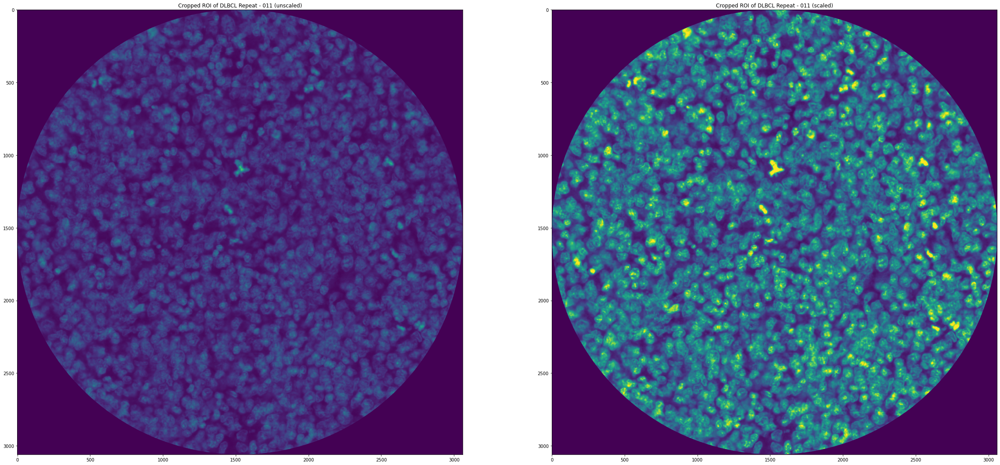

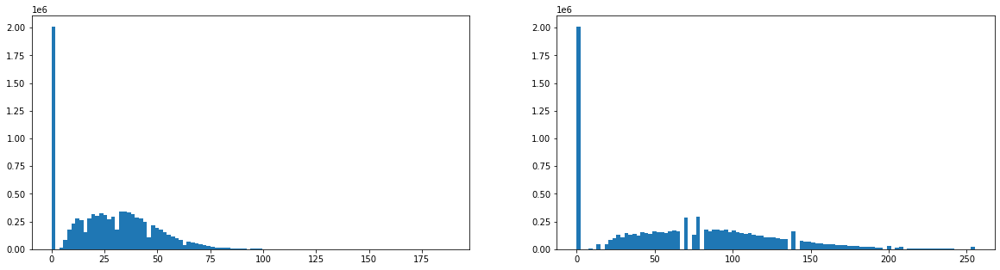

<IPython.core.display.Javascript object>

In [4]:
for i in range(len(dapi_imgs)):
    fig, ax = plt.subplots(figsize=[40, 20], ncols=2)
    ax = ax.flatten()
    ax[0].imshow(dapi_imgs[i], vmin=0, vmax=255)
    ax[0].set_title("Cropped ROI of {} (unscaled)".format(file_names[i]))
    ax[1].imshow(scaled_dapi_imgs[i], vmin=0, vmax=255)
    ax[1].set_title("Cropped ROI of {} (scaled)".format(file_names[i]))
    plt.show()
    plt.close()

    fig, ax = plt.subplots(figsize=[20, 5], ncols=2)
    ax = ax.flatten()
    ax[0].hist(dapi_imgs[i].ravel(), bins=100)
    ax[1].hist(scaled_dapi_imgs[i].ravel(), bins=100)
    plt.show()
    plt.close()

The plots indicate that the differences in the brightness could be resolved, we thus save the cropped and scaled ROI images to disk.

In [5]:
scaled_dapi_img_dir = "../../data/dataset3/images/cropped_scaled/"
os.makedirs(scaled_dapi_img_dir, exist_ok=True)
for i in range(len(scaled_dapi_imgs)):
    img = scaled_dapi_imgs[i]
    tifffile.imsave(os.path.join(scaled_dapi_img_dir, file_names[i]) + ".tif", img)

<IPython.core.display.Javascript object>

---

## 3. Segmentation

We next use a pretrained StarDist model to segment the ROI and identify the boundaries of the individual nuclei. Note that in contrast to the previous data set we use the default probability threshold for the StarDist to segment cells reported in the original publication as we observe a visually better segmentation performance using the other threshold.

In [6]:
image_dir = scaled_dapi_img_dir
output_dir_labels = "../../data/dataset3/images/cropped_scaled_labels/"
output_dir_ijroi = "../../data/dataset3/images/cropped_scaled_ijroi/"
print("Nuclear segmentation........")
segment_objects_stardist2d(
    image_dir=image_dir,
    output_dir_labels=output_dir_labels,
    output_dir_ijroi=output_dir_ijroi,
    use_pretrained=True,
    prob_thresh=0.43,
    # normalize_quants=[1, 99.8],
)

Nuclear segmentation........
Found model '2D_versatile_fluo' for 'StarDist2D'.


2022-06-23 14:40:51.515259: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-23 14:40:51.519884: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-23 14:40:51.520250: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-23 14:40:51.520724: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags

Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.
['../../data/dataset3/images/cropped_scaled/Composite DLBCL - 001.tif', '../../data/dataset3/images/cropped_scaled/Composite DLBCL - 002.tif', '../../data/dataset3/images/cropped_scaled/Composite DLBCL - 003.tif', '../../data/dataset3/images/cropped_scaled/Composite DLBCL - 004.tif', '../../data/dataset3/images/cropped_scaled/Composite DLBCL - 005.tif', '../../data/dataset3/images/cropped_scaled/Composite DLBCL - 006.tif', '../../data/dataset3/images/cropped_scaled/DLBCL Repeat - 007.tif', '../../data/dataset3/images/cropped_scaled/DLBCL Repeat - 008.tif', '../../data/dataset3/images/cropped_scaled/DLBCL Repeat - 009.tif', '../../data/dataset3/images/cropped_scaled/DLBCL Repeat - 010.tif', '../../data/dataset3/images/cropped_scaled/DLBCL Repeat - 011.tif']


2022-06-23 14:40:52.681761: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8200


1/1 [==============================] - 0s 13ms/step


2022-06-23 14:40:54.450128: W tensorflow/core/common_runtime/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.05GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2022-06-23 14:40:54.450158: W tensorflow/core/common_runtime/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.05GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
  0%|                                                                                                                                                                                                    | 0/25 [00:00<?, ?it/s]2022-06-23 14:40:54.793576: W tensorflow/core/common_runtime/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.74GiB with fre

1/1 [==============================] - 2s 2s/step


  4%|███████▌                                                                                                                                                                                    | 1/25 [00:02<00:52,  2.20s/it]

1/1 [==============================] - 0s 16ms/step


  8%|███████████████                                                                                                                                                                             | 2/25 [00:02<00:22,  1.03it/s]

1/1 [==============================] - 0s 15ms/step


 12%|██████████████████████▌                                                                                                                                                                     | 3/25 [00:02<00:13,  1.60it/s]

1/1 [==============================] - 0s 14ms/step


 20%|█████████████████████████████████████▌                                                                                                                                                      | 5/25 [00:02<00:06,  3.09it/s]

1/1 [==============================] - 0s 14ms/step


 28%|████████████████████████████████████████████████████▋                                                                                                                                       | 7/25 [00:02<00:03,  4.55it/s]

1/1 [==============================] - 0s 14ms/step


 36%|███████████████████████████████████████████████████████████████████▋                                                                                                                        | 9/25 [00:03<00:02,  5.91it/s]

1/1 [==============================] - 0s 14ms/step


 40%|██████████████████████████████████████████████████████████████████████████▊                                                                                                                | 10/25 [00:03<00:02,  6.46it/s]

1/1 [==============================] - 0s 15ms/step


 44%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                                        | 11/25 [00:03<00:01,  7.02it/s]

1/1 [==============================] - 0s 14ms/step


 52%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                         | 13/25 [00:03<00:01,  8.15it/s]

1/1 [==============================] - 0s 15ms/step


 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 15/25 [00:03<00:01,  8.87it/s]

1/1 [==============================] - 0s 15ms/step


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 17/25 [00:03<00:00,  9.09it/s]

1/1 [==============================] - 0s 14ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 19/25 [00:04<00:00,  9.61it/s]

1/1 [==============================] - 0s 14ms/step


 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 21/25 [00:04<00:00, 10.02it/s]

1/1 [==============================] - 0s 16ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 23/25 [00:04<00:00, 10.05it/s]

1/1 [==============================] - 0s 14ms/step


  0%|                                                                                                                                                                                                    | 0/25 [00:00<?, ?it/s]

1/1 [==============================] - 2s 2s/step


  4%|███████▌                                                                                                                                                                                    | 1/25 [00:02<00:49,  2.06s/it]

1/1 [==============================] - 0s 22ms/step


  8%|███████████████                                                                                                                                                                             | 2/25 [00:02<00:21,  1.09it/s]

1/1 [==============================] - 0s 22ms/step


 12%|██████████████████████▌                                                                                                                                                                     | 3/25 [00:02<00:12,  1.80it/s]

1/1 [==============================] - 0s 21ms/step


 16%|██████████████████████████████                                                                                                                                                              | 4/25 [00:02<00:08,  2.62it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█████████████████████████████████████▌                                                                                                                                                      | 5/25 [00:02<00:05,  3.54it/s]

1/1 [==============================] - 0s 14ms/step


 28%|████████████████████████████████████████████████████▋                                                                                                                                       | 7/25 [00:02<00:03,  5.41it/s]

1/1 [==============================] - 0s 14ms/step


 36%|███████████████████████████████████████████████████████████████████▋                                                                                                                        | 9/25 [00:02<00:02,  6.84it/s]

1/1 [==============================] - 0s 14ms/step


 44%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                                        | 11/25 [00:03<00:01,  7.92it/s]

1/1 [==============================] - 0s 14ms/step


 52%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                         | 13/25 [00:03<00:01,  8.90it/s]

1/1 [==============================] - 0s 14ms/step


 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 15/25 [00:03<00:01,  9.60it/s]

1/1 [==============================] - 0s 14ms/step


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 17/25 [00:03<00:00,  9.97it/s]

1/1 [==============================] - 0s 15ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 19/25 [00:03<00:00, 10.07it/s]

1/1 [==============================] - 0s 15ms/step


 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 21/25 [00:03<00:00, 10.31it/s]

1/1 [==============================] - 0s 16ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 23/25 [00:04<00:00, 10.58it/s]

1/1 [==============================] - 0s 13ms/step


  0%|                                                                                                                                                                                                    | 0/25 [00:00<?, ?it/s]

1/1 [==============================] - 0s 14ms/step


  4%|███████▌                                                                                                                                                                                    | 1/25 [00:00<00:02,  9.76it/s]

1/1 [==============================] - 0s 14ms/step


 12%|██████████████████████▌                                                                                                                                                                     | 3/25 [00:00<00:02, 10.06it/s]

1/1 [==============================] - 0s 14ms/step


 20%|█████████████████████████████████████▌                                                                                                                                                      | 5/25 [00:00<00:01, 10.65it/s]

1/1 [==============================] - 0s 20ms/step


 28%|████████████████████████████████████████████████████▋                                                                                                                                       | 7/25 [00:00<00:01, 10.57it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███████████████████████████████████████████████████████████████████▋                                                                                                                        | 9/25 [00:00<00:01,  9.82it/s]

1/1 [==============================] - 0s 20ms/step


 40%|██████████████████████████████████████████████████████████████████████████▊                                                                                                                | 10/25 [00:01<00:01,  9.67it/s]

1/1 [==============================] - 0s 20ms/step


 44%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                                        | 11/25 [00:01<00:01,  9.44it/s]

1/1 [==============================] - 0s 20ms/step


 48%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                 | 12/25 [00:01<00:01,  9.37it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                         | 13/25 [00:01<00:01,  9.24it/s]

1/1 [==============================] - 0s 21ms/step


 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 14/25 [00:01<00:01,  9.06it/s]

1/1 [==============================] - 0s 20ms/step


 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 15/25 [00:01<00:01,  8.91it/s]

1/1 [==============================] - 0s 19ms/step


 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 16/25 [00:01<00:00,  9.00it/s]

1/1 [==============================] - 0s 14ms/step


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18/25 [00:01<00:00,  9.66it/s]

1/1 [==============================] - 0s 14ms/step


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 20/25 [00:02<00:00, 10.30it/s]

1/1 [==============================] - 0s 14ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 22/25 [00:02<00:00, 10.64it/s]

1/1 [==============================] - 0s 13ms/step


 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 24/25 [00:02<00:00, 10.80it/s]

1/1 [==============================] - 0s 13ms/step


  0%|                                                                                                                                                                                                    | 0/25 [00:00<?, ?it/s]

1/1 [==============================] - 0s 15ms/step


  8%|███████████████                                                                                                                                                                             | 2/25 [00:00<00:02,  9.97it/s]

1/1 [==============================] - 0s 15ms/step


 12%|██████████████████████▌                                                                                                                                                                     | 3/25 [00:00<00:02,  9.82it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█████████████████████████████████████▌                                                                                                                                                      | 5/25 [00:00<00:02,  9.97it/s]

1/1 [==============================] - 0s 20ms/step


 24%|█████████████████████████████████████████████                                                                                                                                               | 6/25 [00:00<00:01,  9.70it/s]

1/1 [==============================] - 0s 20ms/step


 28%|████████████████████████████████████████████████████▋                                                                                                                                       | 7/25 [00:00<00:01,  9.70it/s]

1/1 [==============================] - 0s 23ms/step


 32%|████████████████████████████████████████████████████████████▏                                                                                                                               | 8/25 [00:00<00:01,  9.41it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███████████████████████████████████████████████████████████████████▋                                                                                                                        | 9/25 [00:00<00:01,  9.39it/s]

1/1 [==============================] - 0s 20ms/step


 40%|██████████████████████████████████████████████████████████████████████████▊                                                                                                                | 10/25 [00:01<00:01,  9.40it/s]

1/1 [==============================] - 0s 20ms/step


 44%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                                        | 11/25 [00:01<00:01,  9.28it/s]

1/1 [==============================] - 0s 20ms/step


 48%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                 | 12/25 [00:01<00:01,  9.38it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                         | 13/25 [00:01<00:01,  9.40it/s]

1/1 [==============================] - 0s 20ms/step


 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 14/25 [00:01<00:01,  9.39it/s]

1/1 [==============================] - 0s 20ms/step


 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 15/25 [00:01<00:01,  9.33it/s]

1/1 [==============================] - 0s 20ms/step


 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 16/25 [00:01<00:00,  9.29it/s]

1/1 [==============================] - 0s 20ms/step


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 17/25 [00:01<00:00,  9.28it/s]

1/1 [==============================] - 0s 22ms/step


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18/25 [00:01<00:00,  9.14it/s]

1/1 [==============================] - 0s 20ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 19/25 [00:02<00:00,  9.22it/s]

1/1 [==============================] - 0s 20ms/step


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 20/25 [00:02<00:00,  9.25it/s]

1/1 [==============================] - 0s 21ms/step


 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 21/25 [00:02<00:00,  9.33it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 22/25 [00:02<00:00,  9.33it/s]

1/1 [==============================] - 0s 14ms/step


 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 24/25 [00:02<00:00,  9.99it/s]

1/1 [==============================] - 0s 13ms/step


  0%|                                                                                                                                                                                                    | 0/25 [00:00<?, ?it/s]

1/1 [==============================] - 0s 14ms/step


  4%|███████▌                                                                                                                                                                                    | 1/25 [00:00<00:02,  9.79it/s]

1/1 [==============================] - 0s 14ms/step


  8%|███████████████                                                                                                                                                                             | 2/25 [00:00<00:02,  9.75it/s]

1/1 [==============================] - 0s 14ms/step


 12%|██████████████████████▌                                                                                                                                                                     | 3/25 [00:00<00:02,  9.71it/s]

1/1 [==============================] - 0s 14ms/step


 20%|█████████████████████████████████████▌                                                                                                                                                      | 5/25 [00:00<00:01, 10.50it/s]

1/1 [==============================] - 0s 14ms/step


 28%|████████████████████████████████████████████████████▋                                                                                                                                       | 7/25 [00:00<00:01, 10.79it/s]

1/1 [==============================] - 0s 14ms/step


 36%|███████████████████████████████████████████████████████████████████▋                                                                                                                        | 9/25 [00:00<00:01, 10.79it/s]

1/1 [==============================] - 0s 13ms/step


 44%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                                        | 11/25 [00:01<00:01, 10.88it/s]

1/1 [==============================] - 0s 14ms/step


 52%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                         | 13/25 [00:01<00:01, 10.99it/s]

1/1 [==============================] - 0s 14ms/step


 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 15/25 [00:01<00:00, 11.05it/s]

1/1 [==============================] - 0s 14ms/step


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 17/25 [00:01<00:00, 10.89it/s]

1/1 [==============================] - 0s 14ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 19/25 [00:01<00:00, 10.99it/s]

1/1 [==============================] - 0s 14ms/step


 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 21/25 [00:01<00:00, 11.12it/s]

1/1 [==============================] - 0s 15ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 23/25 [00:02<00:00, 11.12it/s]

1/1 [==============================] - 0s 14ms/step


  0%|                                                                                                                                                                                                    | 0/25 [00:00<?, ?it/s]

1/1 [==============================] - 2s 2s/step


  4%|███████▌                                                                                                                                                                                    | 1/25 [00:02<00:50,  2.11s/it]

1/1 [==============================] - 0s 14ms/step


 12%|██████████████████████▌                                                                                                                                                                     | 3/25 [00:02<00:13,  1.63it/s]

1/1 [==============================] - 0s 14ms/step


 20%|█████████████████████████████████████▌                                                                                                                                                      | 5/25 [00:02<00:06,  2.93it/s]

1/1 [==============================] - 0s 14ms/step


 28%|████████████████████████████████████████████████████▋                                                                                                                                       | 7/25 [00:02<00:04,  4.26it/s]

1/1 [==============================] - 0s 14ms/step


 36%|███████████████████████████████████████████████████████████████████▋                                                                                                                        | 9/25 [00:02<00:02,  5.54it/s]

1/1 [==============================] - 0s 14ms/step


 44%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                                        | 11/25 [00:02<00:02,  6.75it/s]

1/1 [==============================] - 0s 14ms/step


 52%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                         | 13/25 [00:03<00:01,  7.80it/s]

1/1 [==============================] - 0s 14ms/step


 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 15/25 [00:03<00:01,  8.68it/s]

1/1 [==============================] - 0s 14ms/step


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 17/25 [00:03<00:00,  9.35it/s]

1/1 [==============================] - 0s 14ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 19/25 [00:03<00:00,  9.79it/s]

1/1 [==============================] - 0s 14ms/step


 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 21/25 [00:03<00:00, 10.24it/s]

1/1 [==============================] - 0s 14ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 23/25 [00:04<00:00, 10.55it/s]

1/1 [==============================] - 0s 13ms/step


  0%|                                                                                                                                                                                                    | 0/25 [00:00<?, ?it/s]

1/1 [==============================] - 0s 21ms/step


  4%|███████▌                                                                                                                                                                                    | 1/25 [00:00<00:02,  8.14it/s]

1/1 [==============================] - 0s 20ms/step


  8%|███████████████                                                                                                                                                                             | 2/25 [00:00<00:02,  8.20it/s]

1/1 [==============================] - 0s 22ms/step


 12%|██████████████████████▌                                                                                                                                                                     | 3/25 [00:00<00:02,  8.29it/s]

1/1 [==============================] - 0s 20ms/step


 16%|██████████████████████████████                                                                                                                                                              | 4/25 [00:00<00:02,  8.50it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█████████████████████████████████████▌                                                                                                                                                      | 5/25 [00:00<00:02,  8.73it/s]

1/1 [==============================] - 0s 20ms/step


 24%|█████████████████████████████████████████████                                                                                                                                               | 6/25 [00:00<00:02,  8.73it/s]

1/1 [==============================] - 0s 20ms/step


 28%|████████████████████████████████████████████████████▋                                                                                                                                       | 7/25 [00:00<00:02,  8.89it/s]

1/1 [==============================] - 0s 24ms/step


 32%|████████████████████████████████████████████████████████████▏                                                                                                                               | 8/25 [00:00<00:01,  8.63it/s]

1/1 [==============================] - 0s 16ms/step


 40%|██████████████████████████████████████████████████████████████████████████▊                                                                                                                | 10/25 [00:01<00:01,  9.60it/s]

1/1 [==============================] - 0s 14ms/step


 48%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                 | 12/25 [00:01<00:01, 10.25it/s]

1/1 [==============================] - 0s 14ms/step


 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 14/25 [00:01<00:01, 10.52it/s]

1/1 [==============================] - 0s 14ms/step


 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 16/25 [00:01<00:00, 10.73it/s]

1/1 [==============================] - 0s 13ms/step


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18/25 [00:01<00:00, 10.86it/s]

1/1 [==============================] - 0s 15ms/step


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 20/25 [00:02<00:00, 10.76it/s]

1/1 [==============================] - 0s 14ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 22/25 [00:02<00:00, 10.86it/s]

1/1 [==============================] - 0s 14ms/step


 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 24/25 [00:02<00:00, 11.00it/s]

1/1 [==============================] - 0s 14ms/step


  0%|                                                                                                                                                                                                    | 0/25 [00:00<?, ?it/s]

1/1 [==============================] - 2s 2s/step


  4%|███████▌                                                                                                                                                                                    | 1/25 [00:02<00:50,  2.09s/it]

1/1 [==============================] - 0s 15ms/step


 12%|██████████████████████▌                                                                                                                                                                     | 3/25 [00:02<00:13,  1.65it/s]

1/1 [==============================] - 0s 18ms/step


 16%|██████████████████████████████                                                                                                                                                              | 4/25 [00:02<00:09,  2.30it/s]

1/1 [==============================] - 0s 13ms/step


 24%|█████████████████████████████████████████████                                                                                                                                               | 6/25 [00:02<00:04,  3.82it/s]

1/1 [==============================] - 0s 14ms/step


 32%|████████████████████████████████████████████████████████████▏                                                                                                                               | 8/25 [00:02<00:03,  5.26it/s]

1/1 [==============================] - 0s 13ms/step


 40%|██████████████████████████████████████████████████████████████████████████▊                                                                                                                | 10/25 [00:02<00:02,  6.55it/s]

1/1 [==============================] - 0s 14ms/step


 48%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                 | 12/25 [00:03<00:01,  7.67it/s]

1/1 [==============================] - 0s 14ms/step


 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 14/25 [00:03<00:01,  8.56it/s]

1/1 [==============================] - 0s 13ms/step


 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 16/25 [00:03<00:00,  9.18it/s]

1/1 [==============================] - 0s 14ms/step


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18/25 [00:03<00:00,  9.66it/s]

1/1 [==============================] - 0s 13ms/step


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 20/25 [00:03<00:00, 10.06it/s]

1/1 [==============================] - 0s 13ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 22/25 [00:03<00:00, 10.48it/s]

1/1 [==============================] - 0s 14ms/step


 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 24/25 [00:04<00:00, 10.63it/s]

1/1 [==============================] - 0s 13ms/step


  0%|                                                                                                                                                                                                    | 0/25 [00:00<?, ?it/s]

1/1 [==============================] - 0s 14ms/step


  4%|███████▌                                                                                                                                                                                    | 1/25 [00:00<00:02,  9.94it/s]

1/1 [==============================] - 0s 14ms/step


  8%|███████████████                                                                                                                                                                             | 2/25 [00:00<00:02,  9.82it/s]

1/1 [==============================] - 0s 14ms/step


 16%|██████████████████████████████                                                                                                                                                              | 4/25 [00:00<00:02, 10.34it/s]

1/1 [==============================] - 0s 14ms/step


 24%|█████████████████████████████████████████████                                                                                                                                               | 6/25 [00:00<00:01, 10.86it/s]

1/1 [==============================] - 0s 14ms/step


 32%|████████████████████████████████████████████████████████████▏                                                                                                                               | 8/25 [00:00<00:01, 10.95it/s]

1/1 [==============================] - 0s 20ms/step


 40%|██████████████████████████████████████████████████████████████████████████▊                                                                                                                | 10/25 [00:00<00:01, 10.70it/s]

1/1 [==============================] - 0s 20ms/step


 48%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                 | 12/25 [00:01<00:01, 10.25it/s]

1/1 [==============================] - 0s 20ms/step


 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 14/25 [00:01<00:01,  9.91it/s]

1/1 [==============================] - 0s 20ms/step


 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 15/25 [00:01<00:01,  9.75it/s]

1/1 [==============================] - 0s 20ms/step


 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 16/25 [00:01<00:00,  9.63it/s]

1/1 [==============================] - 0s 20ms/step


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 17/25 [00:01<00:00,  9.46it/s]

1/1 [==============================] - 0s 20ms/step


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18/25 [00:01<00:00,  9.45it/s]

1/1 [==============================] - 0s 20ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 19/25 [00:01<00:00,  9.37it/s]

1/1 [==============================] - 0s 20ms/step


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 20/25 [00:02<00:00,  9.36it/s]

1/1 [==============================] - 0s 20ms/step


 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 21/25 [00:02<00:00,  9.44it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 22/25 [00:02<00:00,  9.36it/s]

1/1 [==============================] - 0s 20ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 23/25 [00:02<00:00,  9.17it/s]

1/1 [==============================] - 0s 20ms/step


 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 24/25 [00:02<00:00,  9.22it/s]

1/1 [==============================] - 0s 20ms/step


  0%|                                                                                                                                                                                                    | 0/25 [00:00<?, ?it/s]

1/1 [==============================] - 0s 15ms/step


  4%|███████▌                                                                                                                                                                                    | 1/25 [00:00<00:02,  9.60it/s]

1/1 [==============================] - 0s 14ms/step


  8%|███████████████                                                                                                                                                                             | 2/25 [00:00<00:02,  9.38it/s]

1/1 [==============================] - 0s 15ms/step


 12%|██████████████████████▌                                                                                                                                                                     | 3/25 [00:00<00:02,  8.98it/s]

1/1 [==============================] - 0s 14ms/step


 20%|█████████████████████████████████████▌                                                                                                                                                      | 5/25 [00:00<00:01, 10.20it/s]

1/1 [==============================] - 0s 14ms/step


 28%|████████████████████████████████████████████████████▋                                                                                                                                       | 7/25 [00:00<00:01, 10.50it/s]

1/1 [==============================] - 0s 14ms/step


 36%|███████████████████████████████████████████████████████████████████▋                                                                                                                        | 9/25 [00:00<00:01, 10.50it/s]

1/1 [==============================] - 0s 14ms/step


 44%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                                        | 11/25 [00:01<00:01, 10.59it/s]

1/1 [==============================] - 0s 14ms/step


 52%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                         | 13/25 [00:01<00:01, 10.89it/s]

1/1 [==============================] - 0s 14ms/step


 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 15/25 [00:01<00:00, 10.61it/s]

1/1 [==============================] - 0s 14ms/step


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 17/25 [00:01<00:00, 10.65it/s]

1/1 [==============================] - 0s 14ms/step


 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 19/25 [00:01<00:00, 10.74it/s]

1/1 [==============================] - 0s 15ms/step


 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 21/25 [00:01<00:00, 10.79it/s]

1/1 [==============================] - 0s 15ms/step


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 23/25 [00:02<00:00, 10.80it/s]

1/1 [==============================] - 0s 13ms/step


  0%|                                                                                                                                                                                                    | 0/25 [00:00<?, ?it/s]

1/1 [==============================] - 0s 22ms/step


  4%|███████▌                                                                                                                                                                                    | 1/25 [00:00<00:02,  8.33it/s]

1/1 [==============================] - 0s 20ms/step


  8%|███████████████                                                                                                                                                                             | 2/25 [00:00<00:02,  8.72it/s]

1/1 [==============================] - 0s 19ms/step


 12%|██████████████████████▌                                                                                                                                                                     | 3/25 [00:00<00:02,  8.89it/s]

1/1 [==============================] - 0s 20ms/step


 16%|██████████████████████████████                                                                                                                                                              | 4/25 [00:00<00:02,  8.99it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█████████████████████████████████████▌                                                                                                                                                      | 5/25 [00:00<00:02,  9.14it/s]

1/1 [==============================] - 0s 14ms/step


 24%|█████████████████████████████████████████████                                                                                                                                               | 6/25 [00:00<00:02,  9.38it/s]

1/1 [==============================] - 0s 15ms/step


 32%|████████████████████████████████████████████████████████████▏                                                                                                                               | 8/25 [00:00<00:01,  9.83it/s]

1/1 [==============================] - 0s 15ms/step


 40%|██████████████████████████████████████████████████████████████████████████▊                                                                                                                | 10/25 [00:01<00:01, 10.03it/s]

1/1 [==============================] - 0s 13ms/step


 48%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                 | 12/25 [00:01<00:01, 10.50it/s]

1/1 [==============================] - 0s 19ms/step


 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 14/25 [00:01<00:01,  9.64it/s]

1/1 [==============================] - 0s 15ms/step


 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 16/25 [00:01<00:00,  9.83it/s]

1/1 [==============================] - 0s 17ms/step


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 17/25 [00:01<00:00,  9.62it/s]

1/1 [==============================] - 0s 17ms/step


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 18/25 [00:01<00:00,  9.54it/s]

1/1 [==============================] - 0s 16ms/step


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 20/25 [00:02<00:00,  9.90it/s]

1/1 [==============================] - 0s 14ms/step


 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 22/25 [00:02<00:00, 10.45it/s]

1/1 [==============================] - 0s 15ms/step


 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 24/25 [00:02<00:00, 10.68it/s]

1/1 [==============================] - 0s 17ms/step


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:02<00:00,  9.97it/s]


<IPython.core.display.Javascript object>

To visualize the segmentation results, we load in the labeled images and plot the segmentation masks overlaid on the scaled ROI images.

In [7]:
visualize_segmentation_results(
    image_dir=image_dir,
    mask_dir=output_dir_labels,
    overlay_output_dir=os.path.join(
        "../../data/dataset3/images/", "segmentation_visualization", "overlay"
    ),
    outline_output_dir=os.path.join(
        "../../data/dataset3/images/", "segmentation_visualization", "outline"
    ),
    alpha=0.3,
)

<IPython.core.display.Javascript object>

---

## 4. Feature extraction

We next extract the chrometric features of the individual nuclei.

In [8]:
output_dir_features = "../../data/dataset3/images/features"
os.makedirs(output_dir_features, exist_ok=True)
# compute nuclear features
print("Nuclear feature extraction........")
nuc_features = extract_nmco_feats_batch(
    raw_image_path=scaled_dapi_img_dir,
    labelled_image_path=output_dir_labels,
    output_dir=output_dir_features,
)

  0%|                                                                                                                                                                                                  | 0/2316 [00:00<?, ?it/s]

Nuclear feature extraction........


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2533/2533 [02:56<00:00, 14.37it/s]


<IPython.core.display.Javascript object>

In [9]:
output_dir_cords = "../../data/dataset3/images/spatial_cords"
os.makedirs(output_dir_cords, exist_ok=True)
spatial_coordiates = extract_spatial_coordinates_batch(
    labelled_image_path=output_dir_labels, output_dir=output_dir_cords
)

<IPython.core.display.Javascript object>

After having extracted the features, we combine those for all regions into one file that we will use for further analysis.

In [10]:
output_dir_consolidated_features = "../../data/dataset3/images/consolidated_features"
os.makedirs(output_dir_consolidated_features, exist_ok=True)
nuc_features["nuc_id"] = (
    nuc_features["image"].astype(str) + "_" + nuc_features["label"].astype(str)
)
nuc_features.to_csv(output_dir_consolidated_features + "/" + "nuc_features.csv")
spatial_coordiates.to_csv(
    output_dir_consolidated_features + "/" + "spatial_coordiates.csv"
)

<IPython.core.display.Javascript object>